In [ ]:
!pip install pydub

This notebook contains sound and signal processing.

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/thinkdsp.py

--2024-09-28 23:54:23--  https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/thinkdsp.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48574 (47K) [text/plain]
Saving to: ‘thinkdsp.py’

thinkdsp.py         100%[===================>]  47.44K  --.-KB/s    in 0.009s  

2024-09-28 23:54:23 (5.39 MB/s) - ‘thinkdsp.py’ saved [48574/48574]



In [ ]:
import matplotlib.pyplot as plt

from thinkdsp import decorate

Read a wave
read_wave reads WAV files. The WAV examples in the book are from freesound.org. In the contributors section of the book, I list and thank the people who uploaded the sounds I use.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from pydub import AudioSegment
audio = AudioSegment.from_file('/content/drive/My Drive/Duke University.m4a')

In [ ]:
wav_filename='Duke_University.wav'
file_handle = audio.export(wav_filename, format='wav')

In [ ]:
from thinkdsp import read_wave

wave = read_wave('Duke_University.wav')

In [ ]:
wave.make_audio()

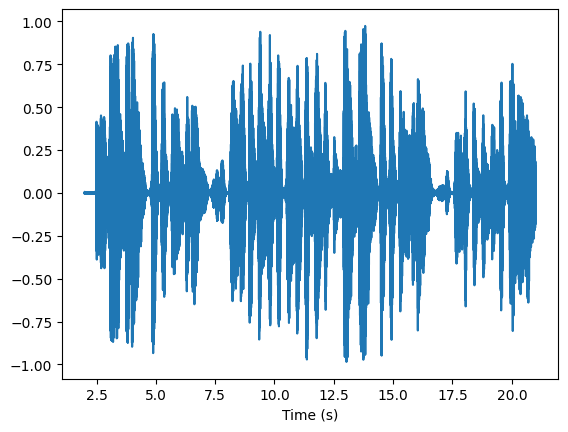

In [ ]:
start = 2
duration = 19
segment = wave.segment(start, duration)
segment.plot()
plt.xlabel('Time (s)');

Spectrums
Transform wave from time domain to frequency domain
Wave provides make_spectrum, which computes the spectrum of the wave.

In [ ]:
spectrum = segment.make_spectrum()

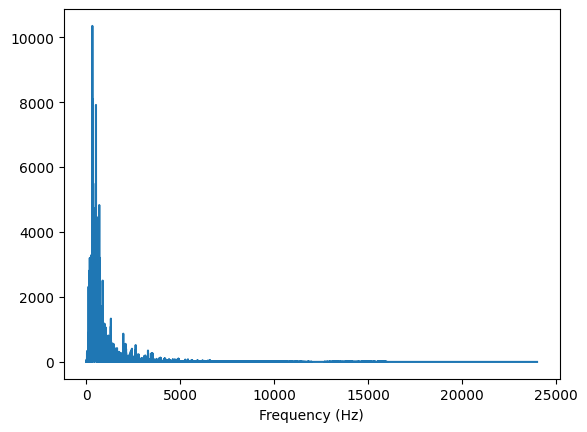

In [ ]:
spectrum.plot()
plt.xlabel('Frequency (Hz)');

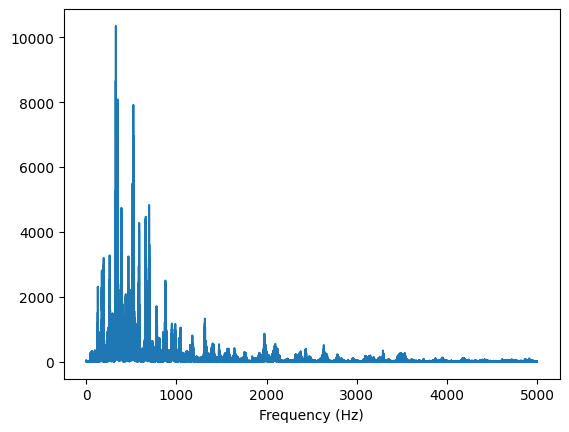

In [ ]:
spectrum.plot(high=5000)
plt.xlabel('Frequency (Hz)');

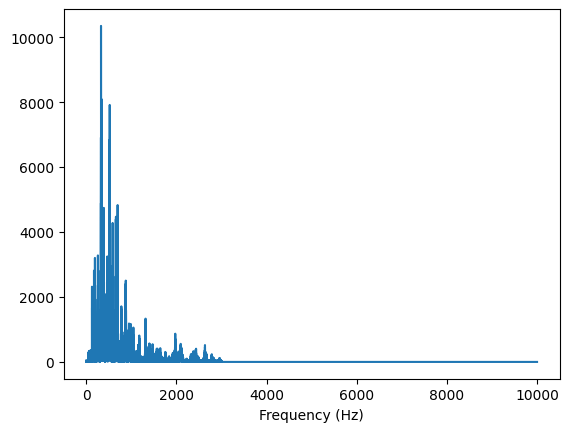

In [ ]:
spectrum.low_pass(3000)
spectrum.plot(high=10000)
plt.xlabel('Frequency (Hz)');

In [ ]:
filtered = spectrum.make_wave()
filtered.make_audio()

In [ ]:
def filter_wave(wave, start, duration, cutoff):
    """Selects a segment from the wave and filters it.

    Plots the spectrum and displays an Audio widget.

    wave: Wave object
    start: time in s
    duration: time in s
    cutoff: frequency in Hz
    """
    segment = wave.segment(start, duration)
    spectrum = segment.make_spectrum()

    spectrum.plot(color='0.7')
    spectrum.low_pass(cutoff)
    spectrum.plot()
    plt.xlabel('Frequency (Hz)');
    plt.show()

    audio = spectrum.make_wave().make_audio()
    display(audio)

In [ ]:
from ipywidgets import interact, fixed
from IPython.display import display

wave = read_wave('Duke_University.wav')
interact(filter_wave, wave=fixed(wave),
         start=(0, 5, 0.1), duration=(0, 5, 0.1), cutoff=(0, 10000, 100));

interactive(children=(FloatSlider(value=2.0, description='start', max=5.0), FloatSlider(value=2.0, description…